# Plant Disease Detection & Classification

# Problem Statement
Misdiagnosis of the many diseases impacting agricultural crops can lead to misuse of chemicals leading to the emergence of resistant pathogen strains, increased input costs, and more outbreaks with significant economic loss and environmental impacts. Current disease diagnosis based on human scouting is time-consuming and expensive, and although computer-vision based models have the promise to increase efficiency, the great variance in symptoms due to age of infected tissues, genetic variations, and light conditions within trees decreases the accuracy of detection.

# Specific Objectives
Objectives of `Plant Disease Detection & Classification` are to train a model using images of training dataset to do the following.
1. Accurately classify a given image from testing dataset into different diseased category or a healthy leaf.
2. Accurately distinguish between many diseases, sometimes more than one on a single leaf.
3. Deal with rare classes and novel symptoms.
4. Address depth perception—angle, light, shade, physiological age of the leaf.
5. Incorporate expert knowledge in identification, annotation, quantification, and guiding computer vision to search for relevant features during learning.

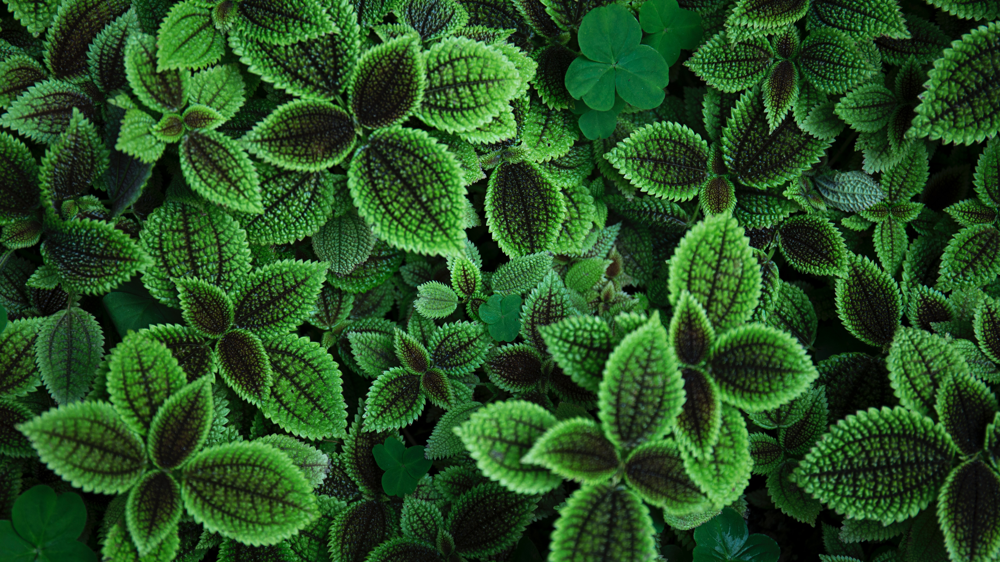

In [1]:
from IPython.display import Image
Image(filename='/home/indiano/Desktop/ren-ran-Jy6luiLBsrk-unsplash.jpg')

> # 1. Imports <a id="1"></a>

In [2]:
import os
import gc
import re

import cv2
import math
import numpy as np
import scipy as sp
import pandas as pd

from sklearn import metrics
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.applications import DenseNet121
import tensorflow.keras.layers as L
import tensorflow.keras.backend as K
from tensorflow.keras.models import Model

import efficientnet.tfkeras as efn
from keras.utils import plot_model
from keras.utils import model_to_dot

#from kaggle_datasets import KaggleDatasets

from IPython.display import SVG
from tqdm import tqdm
tqdm.pandas()
from PIL import Image
import hashlib

import seaborn as sns
import matplotlib.cm as cm
import matplotlib.pyplot as plt

import plotly.express as px
import plotly.graph_objects as go
import plotly.figure_factory as ff
from plotly.subplots import make_subplots

np.random.seed(0)
tf.random.set_seed(0)

import warnings
warnings.filterwarnings("ignore")

Using TensorFlow backend.
/home/indiano/anaconda3/envs/plantdisease/lib/python3.7/site-packages/tqdm/std.py:668: FutureWarning: The Panel class is removed from pandas. Accessing it from the top-level namespace will also be removed in the next version
  from pandas import Panel


> # 2. EDA <a id="2"></a>

## Files, folders & Parameters

In [3]:
EPOCHS = 5
SAMPLE_LEN = 100

root_dir = "/home/indiano/code/plant"
data_dir = "/home/indiano/datasets/plant-pathology-2020-fgvc7"

# Get list of all files & folders
os.listdir(root_dir)

['data',
 'models',
 'src',
 'README.md',
 'notebooks',
 '.ipynb_checkpoints',
 'checkpoint',
 'docs',
 'LICENSE']

In [4]:
images_dir = os.path.join(data_dir, 'images')
train_path = os.path.join(data_dir, 'train.csv')
test_path = os.path.join(data_dir, 'test.csv')

train_df = pd.read_csv(train_path)
test_df = pd.read_csv(test_path)

## Train & Test data exploration

### Helper functions for laoding images

In [5]:
def load_image_path(image_id):
    return (os.path.join(images_dir, image_id) + '.jpg')

train = train_df.image_id.apply(load_image_path).values
test = test_df.image_id.apply(load_image_path).values

train_labels = np.float32(train_df.loc[:, 'healthy':'scab'].values)

In [6]:
def load_image(image_id):
    image = cv2.imread(os.path.join(images_dir, image_id + ".jpg"))
    return cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

train_images = train_df["image_id"][:SAMPLE_LEN].progress_apply(load_image)

100%|██████████| 100/100 [00:10<00:00,  9.19it/s]


### Load data & labels

In [7]:
train_df.head()

,image_id,healthy,multiple_diseases,rust,scab
0,Train_0,0,0,0,1
1,Train_1,0,1,0,0
2,Train_2,1,0,0,0
3,Train_3,0,0,1,0
4,Train_4,1,0,0,0


In [8]:
train_df_disease_count_series = train_df.iloc[:, 1:].sum(axis = 0, skipna = True) 
train_df_disease_count_frame = train_df_disease_count_series.to_frame().reset_index()
train_df_disease_count_frame.columns = ['Class', 'Count']
train_df_disease_count_frame

,Class,Count
0,healthy,516
1,multiple_diseases,91
2,rust,622
3,scab,592


### Image metadata

Let's calculate image metadata and find out duplicate images.

In [9]:
def calculate_hash(image):
    md5 = hashlib.md5()
    md5.update(np.array(image).tostring())
    return md5.hexdigest()
    
def get_image_metadata(image_id, dataset='train'):
    image = Image.open(os.path.join(images_dir, image_id + ".jpg"))
    extrema = image.getextrema()

    metadata = {
        'image_id': image_id,
        'dataset': dataset,
        'hash': calculate_hash(image),
        'r_min': extrema[0][0],
        'r_max': extrema[0][1],
        'g_min': extrema[1][0],
        'g_max': extrema[1][1],
        'b_min': extrema[2][0],
        'b_max': extrema[2][1],
        'height': image.size[0],
        'width': image.size[1],
        'format': image.format,
        'mode': image.mode
    }
    return metadata

In [10]:
train_metadata = train_df.image_id.apply(get_image_metadata).values
train_metadata_df = pd.DataFrame(list(train_metadata), columns=['image_id', 'dataset', 'hash', 'r_min', 
                                          'r_max', 'g_min', 'g_max', 'b_min', 
                                          'b_max', 'height', 'width', 'format', 'mode'])
train_metadata_df.head()

,image_id,dataset,hash,r_min,r_max,g_min,g_max,b_min,b_max,height,width,format,mode
0,Train_0,train,0ed246432c166ea6b26ab531a0e14654,15,252,14,255,0,255,2048,1365,JPEG,RGB
1,Train_1,train,f2c4f0f0f3574c1722105635fb29d2ff,39,255,22,255,0,255,2048,1365,JPEG,RGB
2,Train_2,train,1ff49f8cd108961f3313eb8214195386,17,255,34,255,6,255,2048,1365,JPEG,RGB
3,Train_3,train,855994deab78d03bf29de8746eb84cda,18,255,26,255,0,255,2048,1365,JPEG,RGB
4,Train_4,train,3b8877a0a32112001c6e405131aab4f3,18,238,46,255,0,250,2048,1365,JPEG,RGB


In [11]:
test_metadata = test_df.image_id.apply(get_image_metadata, dataset='test').values
test_metadata_df = pd.DataFrame(list(test_metadata), columns=['image_id', 'dataset', 'hash', 'r_min', 
                                          'r_max', 'g_min', 'g_max', 'b_min', 
                                          'b_max', 'height', 'width', 'format', 'mode'])
test_metadata_df.head()

,image_id,dataset,hash,r_min,r_max,g_min,g_max,b_min,b_max,height,width,format,mode
0,Test_0,test,10a2ca4ef3ab51c8b98caf0e05124598,5,255,14,255,0,255,2048,1365,JPEG,RGB
1,Test_1,test,a52f49f59d59e864661b2deb12c25647,13,255,31,255,0,255,2048,1365,JPEG,RGB
2,Test_2,test,a538dd90bae108e09a74eae5cc5702cd,5,250,9,233,0,217,2048,1365,JPEG,RGB
3,Test_3,test,eb53e4f291debb781e802cc85b302782,14,199,47,223,0,220,2048,1365,JPEG,RGB
4,Test_4,test,1e408ae3af727c4ff10f20f1802fc11d,16,255,15,255,0,255,2048,1365,JPEG,RGB


In [12]:
all_metadata_df = train_metadata_df.append(test_metadata_df)
all_metadata_df.head()

,image_id,dataset,hash,r_min,r_max,g_min,g_max,b_min,b_max,height,width,format,mode
0,Train_0,train,0ed246432c166ea6b26ab531a0e14654,15,252,14,255,0,255,2048,1365,JPEG,RGB
1,Train_1,train,f2c4f0f0f3574c1722105635fb29d2ff,39,255,22,255,0,255,2048,1365,JPEG,RGB
2,Train_2,train,1ff49f8cd108961f3313eb8214195386,17,255,34,255,6,255,2048,1365,JPEG,RGB
3,Train_3,train,855994deab78d03bf29de8746eb84cda,18,255,26,255,0,255,2048,1365,JPEG,RGB
4,Train_4,train,3b8877a0a32112001c6e405131aab4f3,18,238,46,255,0,250,2048,1365,JPEG,RGB


#### Image Orientation

It looks like we have both portrait and landscape modes in the train and the test set as well. The image size is always 2048x1368px (or 1365x2048).

In [13]:
all_metadata_df.groupby(by='dataset')[['width', 'height']].aggregate(['min', 'max'])

width       height      
          min   max    min   max
dataset                         
test     1365  2048   1365  2048
train    1365  2048   1365  2048

#### Image Duplicates

In [14]:
duplicates = all_metadata_df.groupby(by='hash')[['image_id']].count().reset_index()
duplicates = duplicates[duplicates['image_id'] > 1]
duplicates.reset_index(drop=True, inplace=True)

duplicates = duplicates.merge(all_metadata_df[['image_id', 'hash']], on='hash')

duplicates.head(20)

,hash,image_id_x,image_id_y
0,39cdbff63bcd5ec83cbf4e2f6147eb12,2,Train_1703
1,39cdbff63bcd5ec83cbf4e2f6147eb12,2,Test_1407
2,53e14328863405b825081244e44f16b3,2,Test_570
3,53e14328863405b825081244e44f16b3,2,Test_1212
4,a2570beaaaf16d50f7caecd7c7d51976,2,Test_683
5,a2570beaaaf16d50f7caecd7c7d51976,2,Test_1691
6,aeb03a2a591c5ec0646d71f585aa1d4d,2,Train_1505
7,aeb03a2a591c5ec0646d71f585aa1d4d,2,Test_829
8,de57848ea38eaa59ac8a2b417620084a,2,Train_379
9,de57848ea38eaa59ac8a2b417620084a,2,Train_1173


## Data count for each labels

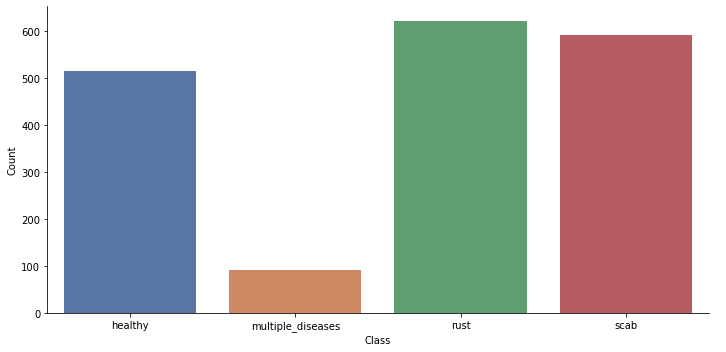

In [15]:
# Plot plants by diesease class and count

seaborn = sns.FacetGrid(train_df_disease_count_frame, size=5, aspect=2)
seaborn.map(sns.barplot, 'Class', 'Count', palette='deep')
seaborn.set_xticklabels(rotation=0)
seaborn.add_legend()

## Data understanding

### Load sample images

In [16]:
def load_image(image_id):
    image = cv2.imread(os.path.join(images_dir, image_id + ".jpg"))
    return cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

train_images = train_df["image_id"][:SAMPLE_LEN].progress_apply(load_image)

100%|██████████| 100/100 [00:03<00:00, 27.73it/s]


### Visualize leaves

In [17]:
def visualize_leaves(cond=[0, 0, 0, 0], cond_cols=["healthy"], rows=3, cols=3, is_cond=True):
    if not is_cond:
        cols, rows = 3, min([3, len(train_images)//3])
        fig, ax = plt.subplots(nrows=rows, ncols=cols, figsize=(30, rows*20/3))
        for col in range(cols):
            for row in range(rows):
                ax[row, col].imshow(train_images.loc[train_images.index[-row*3-col-1]])
        return None
        
    cond_0 = "healthy == {}".format(cond[0])
    cond_1 = "scab == {}".format(cond[1])
    cond_2 = "rust == {}".format(cond[2])
    cond_3 = "multiple_diseases == {}".format(cond[3])
    
    cond_list = []
    for col in cond_cols:
        if col == "healthy":
            cond_list.append(cond_0)
        if col == "scab":
            cond_list.append(cond_1)
        if col == "rust":
            cond_list.append(cond_2)
        if col == "multiple_diseases":
            cond_list.append(cond_3)
    
    data = train_df.loc[:SAMPLE_LEN-1]
    for cond in cond_list:
        data = data.query(cond)
        
    images = train_images.iloc[list(data.index)]
    cols, rows = cols, min([rows, len(images)//cols])
    
    fig, ax = plt.subplots(nrows=rows, ncols=cols, figsize=(30, rows*20/3))
    for col in range(cols):
        for row in range(rows):
            ax[row, col].imshow(images.loc[images.index[row*3+col]])
    plt.show()

#### Show Images

In [18]:
def show_images(image_id, cols=3):
    
    col = cols
    row = min(len(image_id) // cols, 3)
    
    fig, ax = plt.subplots(row, col, figsize=(16, 8))
    ax = ax.flatten()

    for i, image_id in enumerate(image_id):
        image = cv2.imread(images_dir + '/{}.jpg'.format(image_id))
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        
        ax[i].set_axis_off()
        ax[i].imshow(image)
        ax[i].set_title(image_id)

#### Visualize a leaf

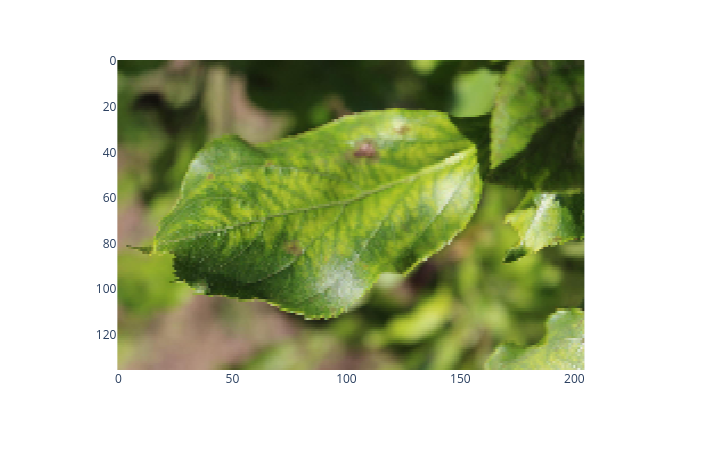

In [19]:
fig = px.imshow(cv2.resize(train_images[0], (205, 136)))
fig.show()

I have plotted the first image in the training data above (the RGB values can be seen by hovering over the image). The green parts of the image have very low blue values, but by contrast, the brown parts have high blue values. This suggests that green (healthy) parts of the image have low blue values, whereas unhealthy parts are more likely to have high blue values. **This might suggest that the blue channel may be the key to detecting diseases in plants.**

### Channel distributions <a id="1.3"></a>

In [20]:
red_mean_values = [np.mean(train_images[idx][:, :, 0]) for idx in range(len(train_images))]
green_mean_values = [np.mean(train_images[idx][:, :, 1]) for idx in range(len(train_images))]
blue_mean_values = [np.mean(train_images[idx][:, :, 2]) for idx in range(len(train_images))]
total_mean_values = [np.mean(train_images[idx]) for idx in range(len(train_images))]

#### All channel mean values

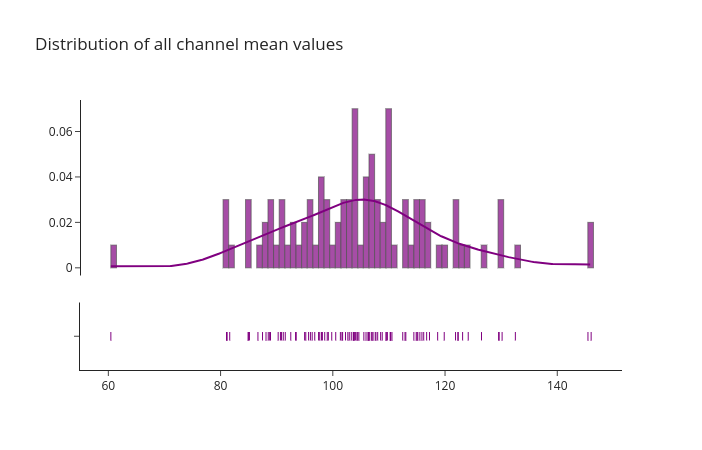

In [21]:
fig = ff.create_distplot([total_mean_values], group_labels=["Channels"], colors=["purple"])
fig.update_layout(showlegend=False, template="simple_white")
fig.update_layout(title_text="Distribution of all channel mean values")
fig.data[0].marker.line.color = 'rgb(0, 0, 0)'
fig.data[0].marker.line.width = 0.5
fig

The channel values seem to have a roughly normal distribution centered around 105. The maximum channel activation is 255 and the average channel value is less than half the maximum value, which indicates that channels are minimally activated most of the time.

#### Red Channel mean values

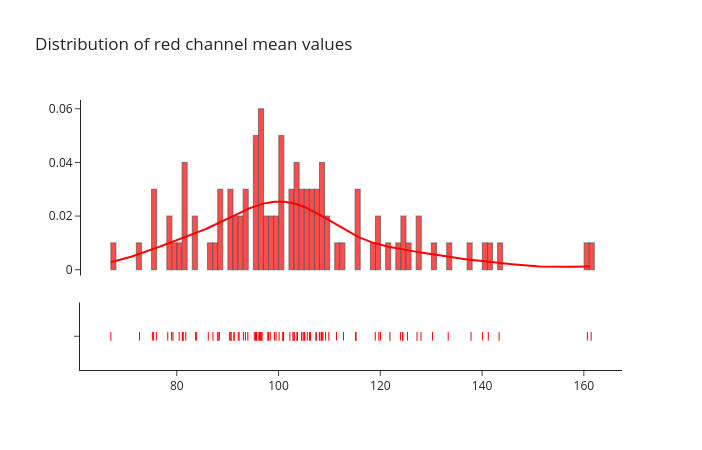

In [22]:
fig = ff.create_distplot([red_mean_values], group_labels=["R"], colors=["red"])
fig.update_layout(showlegend=False, template="simple_white")
fig.update_layout(title_text="Distribution of red channel mean values")
fig.data[0].marker.line.color = 'rgb(0, 0, 0)'
fig.data[0].marker.line.width = 0.5
fig

The red channel values seem to roughly normal distribution, but with a slight rightward (positive skew). This indicates that the red channel tends to be more concentrated at lower values, at around 100. There is large variation in average red values across images.

#### Green channel mean values

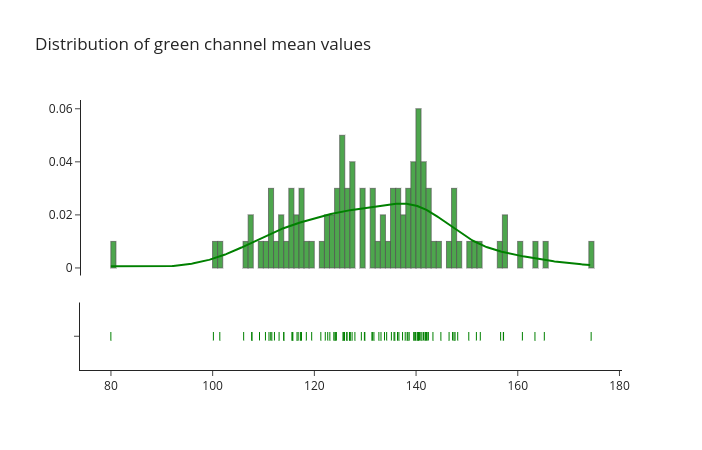

In [23]:
fig = ff.create_distplot([green_mean_values], group_labels=["G"], colors=["green"])
fig.update_layout(showlegend=False, template="simple_white")
fig.update_layout(title_text="Distribution of green channel mean values")
fig.data[0].marker.line.color = 'rgb(0, 0, 0)'
fig.data[0].marker.line.width = 0.5
fig

The green channel values have a more uniform distribution than the red channel values, with a smaller peak. The distribution also has a leftward skew (in contrast to red) and a larger mode of around 140. This indicates that green is more pronounced in these images than red, which makes sense, because these are images of leaves!

#### Blue channel mean values

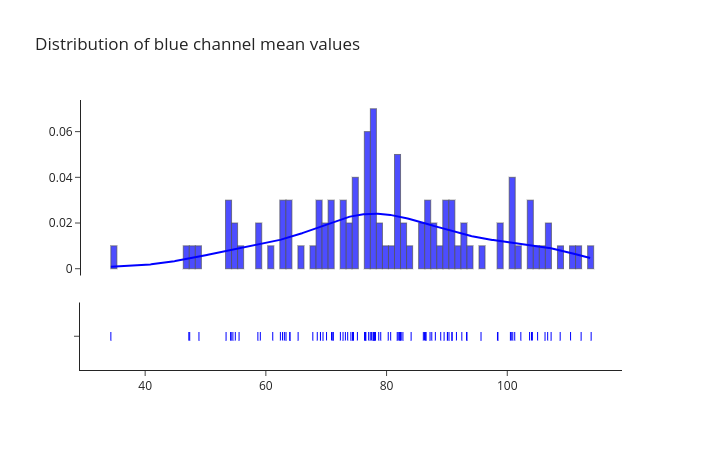

In [24]:
fig = ff.create_distplot([blue_mean_values], group_labels=["B"], colors=["blue"])
fig.update_layout(showlegend=False, template="simple_white")
fig.update_layout(title_text="Distribution of blue channel mean values")
fig.data[0].marker.line.color = 'rgb(0, 0, 0)'
fig.data[0].marker.line.width = 0.5
fig

The blue channel has the most uniform distribution out of the three color channels, with minimal skew (slight leftward skew). The blue channel shows great variation across images in the dataset.

### All Channel Mean Values vs RGB Channel Mean Values

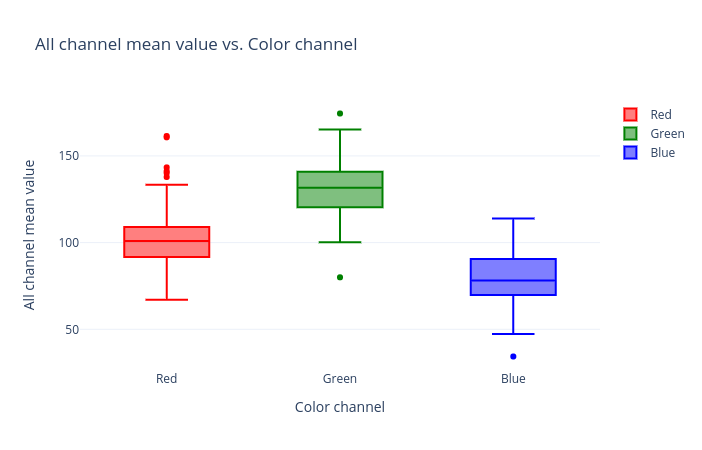

In [25]:
fig = go.Figure()

for idx, values in enumerate([red_mean_values, green_mean_values, blue_mean_values]):
    if idx == 0:
        color = "Red"
    if idx == 1:
        color = "Green"
    if idx == 2:
        color = "Blue"
    fig.add_trace(go.Box(x=[color]*len(values), y=values, name=color, marker=dict(color=color.lower())))
    
fig.update_layout(yaxis_title="All channel mean value", xaxis_title="Color channel",
                  title="All channel mean value vs. Color channel", template="plotly_white")

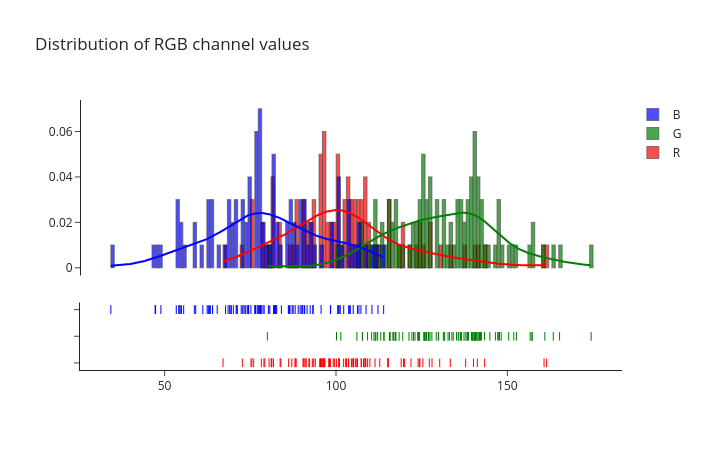

In [26]:
fig = ff.create_distplot([red_mean_values, green_mean_values, blue_mean_values],
                         group_labels=["R", "G", "B"],
                         colors=["red", "green", "blue"])
fig.update_layout(title_text="Distribution of RGB channel values", template="simple_white")
fig.data[0].marker.line.color = 'rgb(0, 0, 0)'
fig.data[0].marker.line.width = 0.5
fig.data[1].marker.line.color = 'rgb(0, 0, 0)'
fig.data[1].marker.line.width = 0.5
fig.data[2].marker.line.color = 'rgb(0, 0, 0)'
fig.data[2].marker.line.width = 0.5
fig

From the above plots, we can clearly see which colors are more common and which ones less common in the leaf images. Green is the most pronounced color, followed by red and blue respectively. The distributions, when plotted together, appear to have a similar shape, but shifted horizontally. 

### Visualize different types of leaf

#### Train images

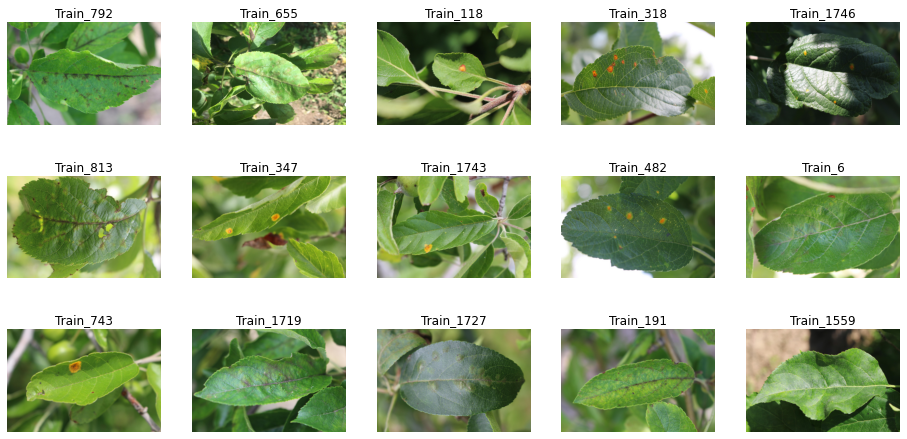

In [27]:
show_images(train_df.sample(n=15)['image_id'].values, cols=5)

#### Test Images

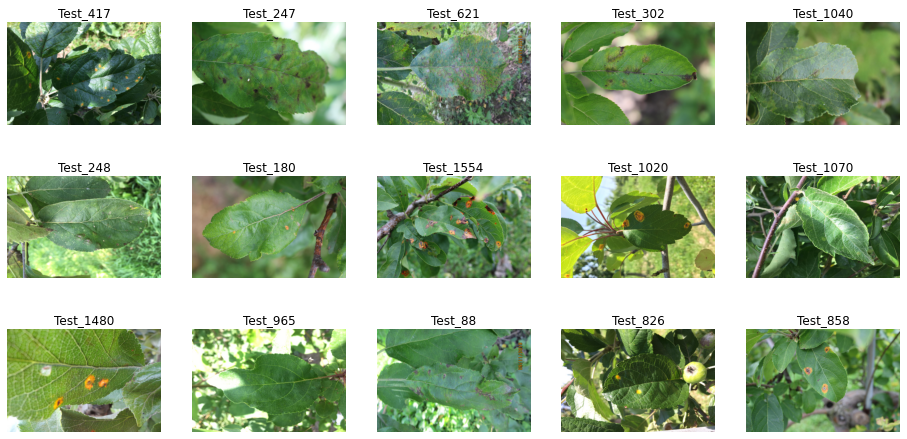

In [28]:
show_images(test_df.sample(n=15)['image_id'].values, cols=5)

#### Healthy Leaves

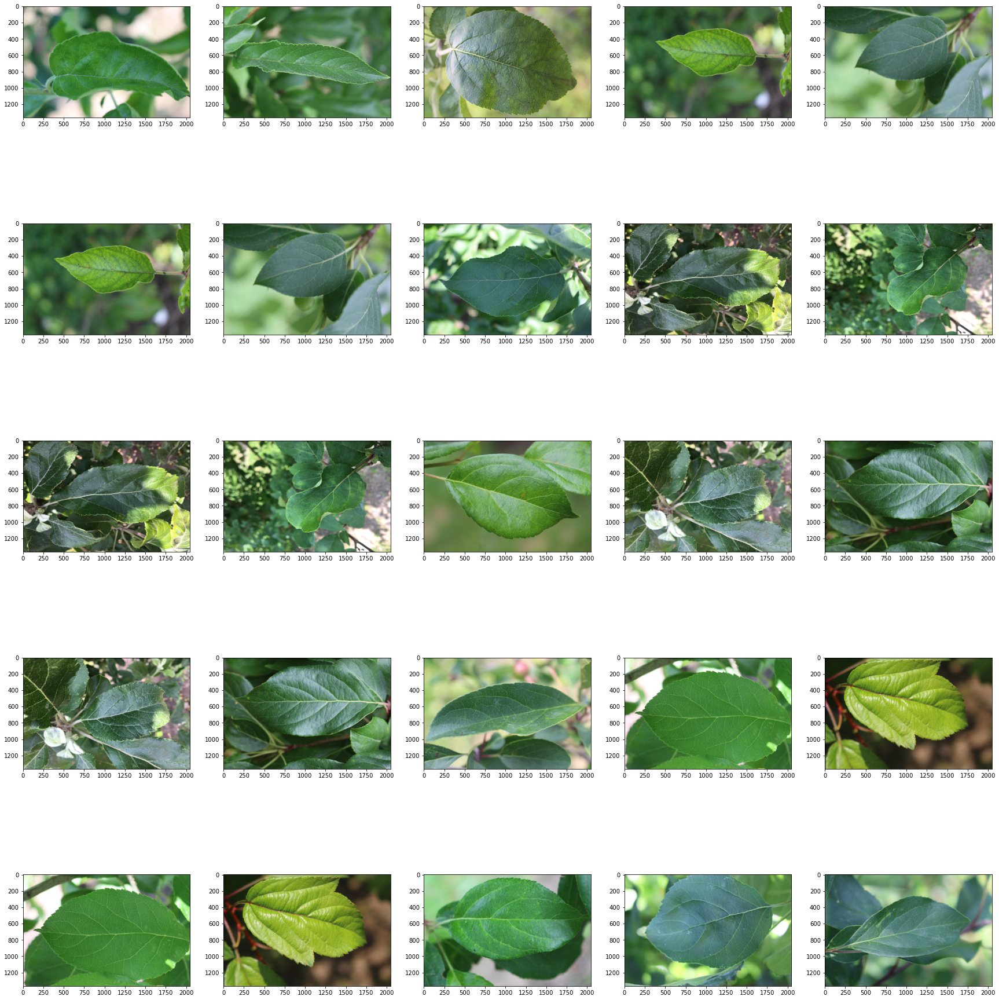

In [29]:
visualize_leaves(cond=[1, 0, 0, 0], cond_cols=["healthy"], rows=5, cols=5)

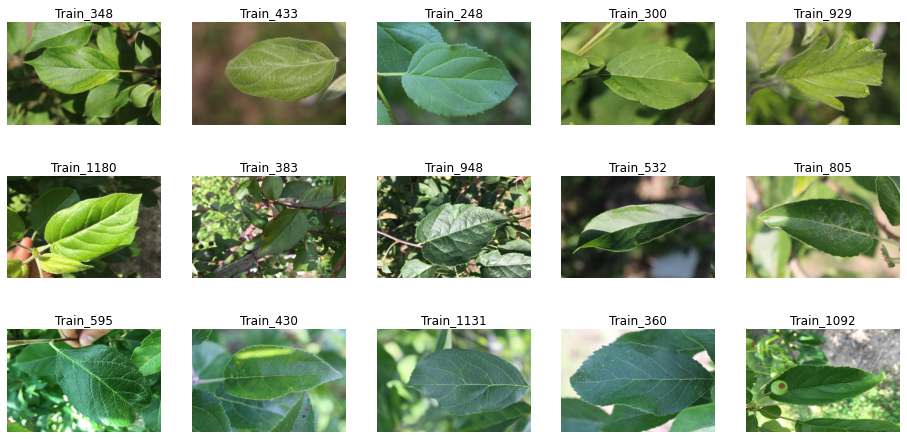

In [30]:
show_images(train_df[train_df['healthy'] == 1].sample(n=15)['image_id'].values, cols=5)

#### Leaves with scab

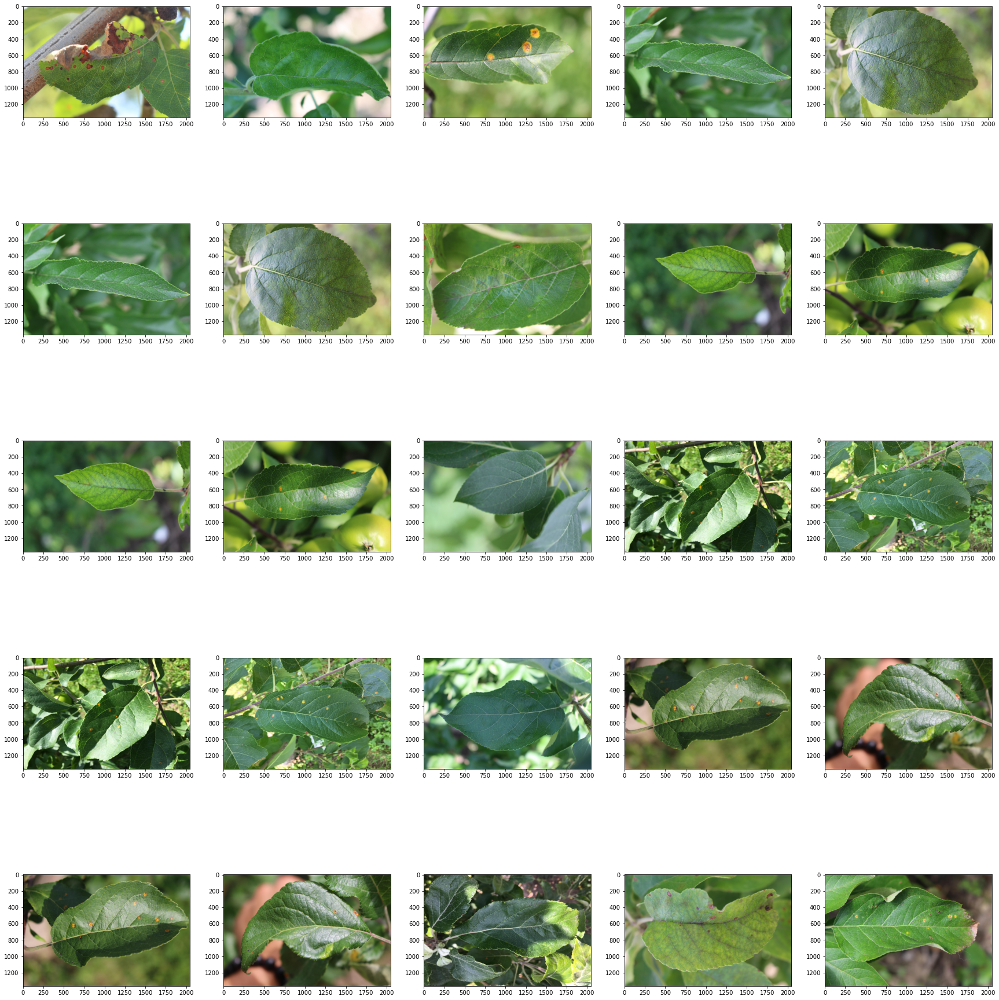

In [31]:
visualize_leaves(cond=[1, 0, 0, 0], cond_cols=["scab"], rows=5, cols=5)

In the above images, we can see that leaves with "scab" have large brown marks and stains across the leaf. Scab is defined as "any of various plant diseases caused by fungi or bacteria and resulting in crustlike spots on fruit, leaves, or roots. The spots caused by such a disease". The brown marks across the leaf are a sign of these bacterial/fungal infections. Once diagnosed, scab can be treated using chemical or non-chemical methods.

#### Leaves with rust

In the bellow images, we can see that leaves with "rust" have several brownish-yellow spots across the leaf. Rust is defined as "a disease, especially of cereals and other grasses, characterized by rust-colored pustules of spores on the affected leaf blades and sheaths and caused by any of several rust fungi". The yellow spots are a sign of infection by a special type of fungi called "rust fungi". Rust can also be treated with several chemical and non-chemical methods once diagnosed.

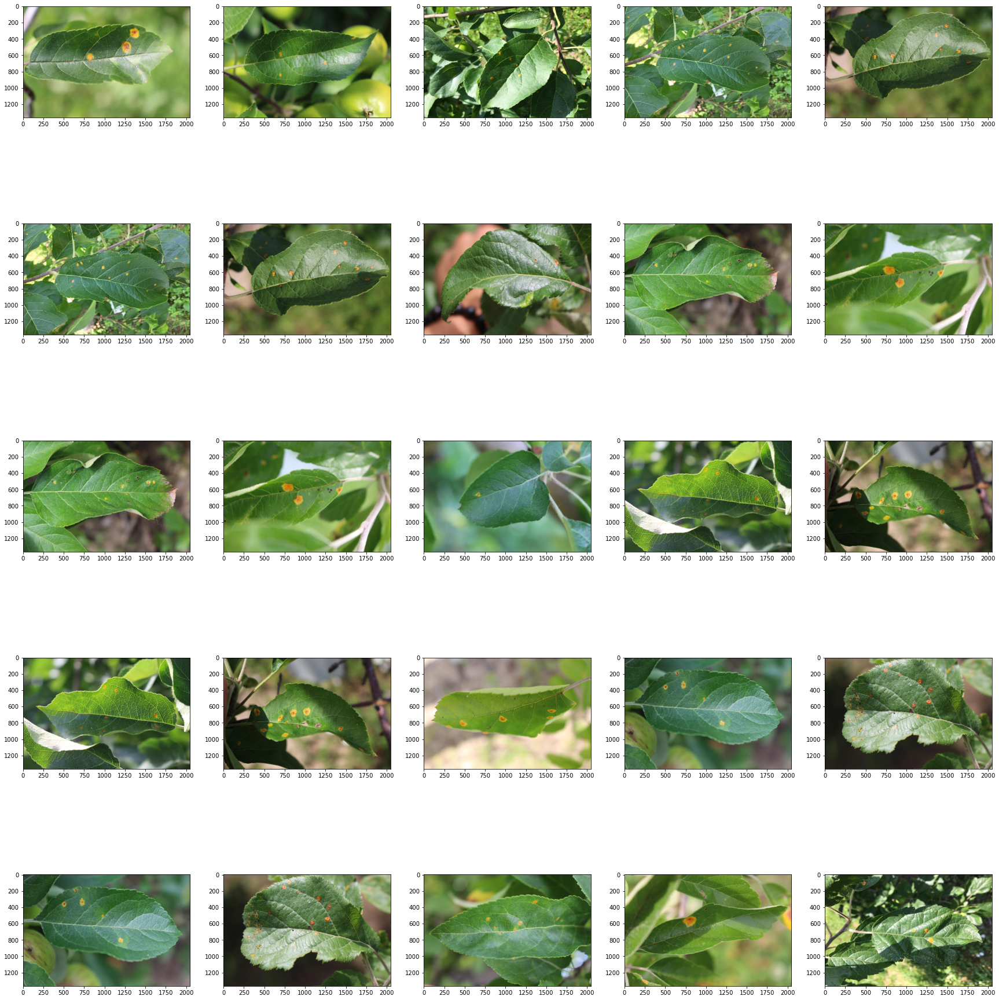

In [32]:
visualize_leaves(cond=[0, 0, 1, 0], cond_cols=["rust"], rows=5, cols=5)

#### Leaves with multiple disease

In the bellow images, we can see that the leaves show symptoms for several diseases, including brown marks and yellow spots. These plants have more than one of the above-described diseases.

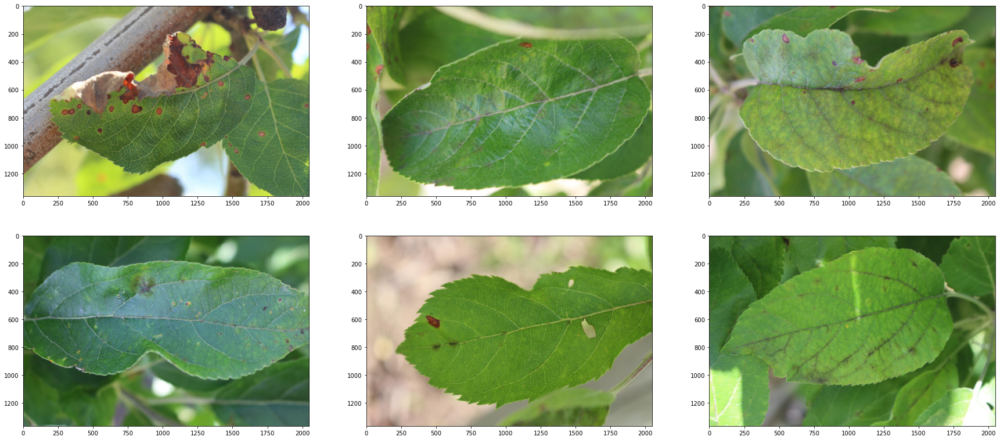

In [33]:
visualize_leaves(cond=[0, 0, 0, 1], cond_cols=["multiple_diseases"], rows=3, cols=3)

### Visualize labels

Now, I will visualize the labels and target data. In all the below plots, blue represents the `desired` or `healthy` condition, and red represents the `undesired` or `unhealthy` condition.

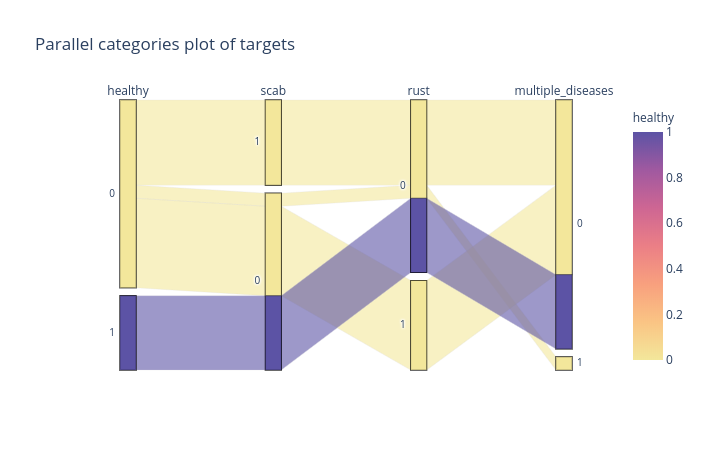

In [34]:
fig = px.parallel_categories(train_df[["healthy", "scab", "rust", "multiple_diseases"]], color="healthy", color_continuous_scale="sunset",\
                             title="Parallel categories plot of targets")
fig.show()

In the above plot, we can see the relationship between all four categories. As expected, it is impossible for a healthy leaf (<code>healthy == 1</code>) to have scab, rust, or multiple diseases. Also, every unhealthy leaf has one of either scab, rust, or multiple diseases. The frequency of each combination can be seen by hovering over the plot.

### Pie chart

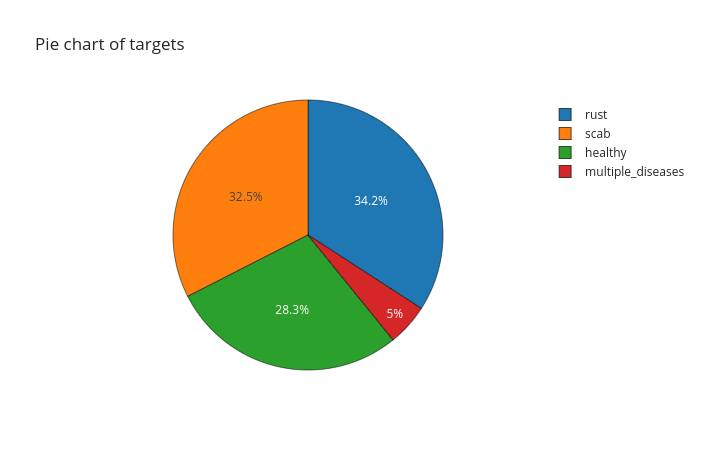

In [35]:
fig = go.Figure([go.Pie(labels=train_df.columns[1:],
           values=train_df.iloc[:, 1:].sum().values)])
fig.update_layout(title_text="Pie chart of targets", template="simple_white")
fig.data[0].marker.line.color = 'rgb(0, 0, 0)'
fig.data[0].marker.line.width = 0.5
fig.show()

#### Healthy Distribution

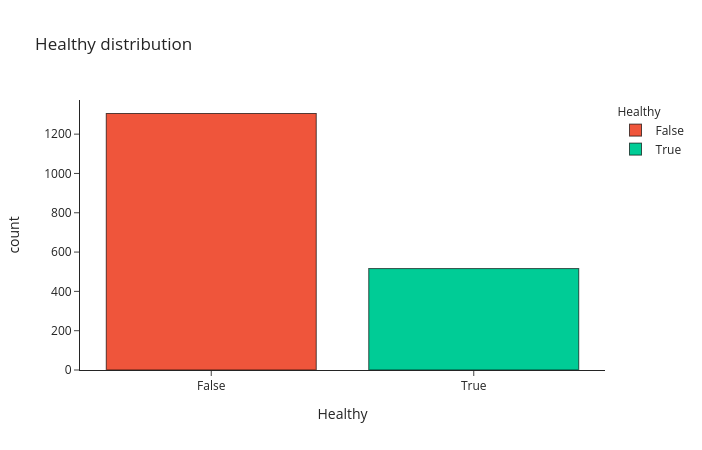

In [36]:
train_df["Healthy"] = train_df["healthy"].apply(bool).apply(str)
fig = px.histogram(train_df, x="Healthy", title="Healthy distribution", color="Healthy",\
            color_discrete_map={
                "True": px.colors.qualitative.Plotly[2],
                "False": px.colors.qualitative.Plotly[1]})
fig.update_layout(template="simple_white")
fig.data[0].marker.line.color = 'rgb(0, 0, 0)'
fig.data[0].marker.line.width = 0.5
fig.data[1].marker.line.color = 'rgb(0, 0, 0)'
fig.data[1].marker.line.width = 0.5
fig

#### Scab Distribution

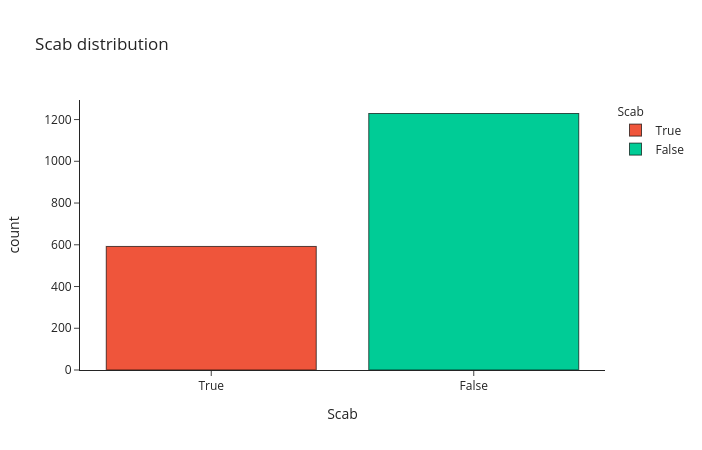

In [37]:
train_df["Scab"] = train_df["scab"].apply(bool).apply(str)
fig = px.histogram(train_df, x="Scab", color="Scab", title="Scab distribution",\
            color_discrete_map={
                "True": px.colors.qualitative.Plotly[1],
                "False": px.colors.qualitative.Plotly[2]})
fig.update_layout(template="simple_white")
fig.data[0].marker.line.color = 'rgb(0, 0, 0)'
fig.data[0].marker.line.width = 0.5
fig.data[1].marker.line.color = 'rgb(0, 0, 0)'
fig.data[1].marker.line.width = 0.5
fig

#### Rust distribution

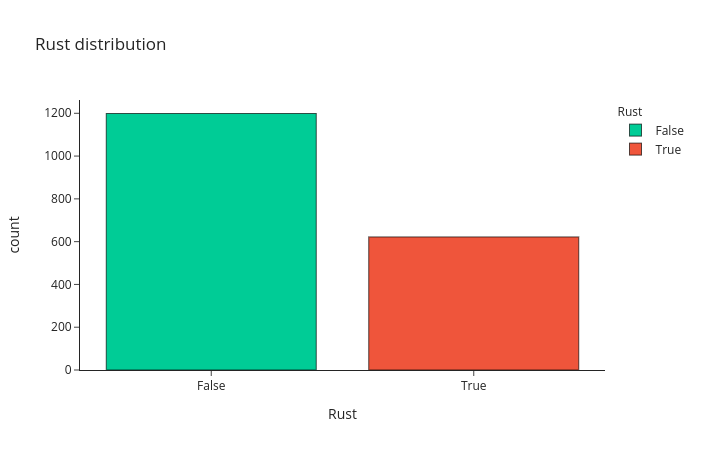

In [38]:
train_df["Rust"] = train_df["rust"].apply(bool).apply(str)
fig = px.histogram(train_df, x="Rust", color="Rust", title="Rust distribution",\
            color_discrete_map={
                "True": px.colors.qualitative.Plotly[1],
                "False": px.colors.qualitative.Plotly[2]})
fig.update_layout(template="simple_white")
fig.data[0].marker.line.color = 'rgb(0, 0, 0)'
fig.data[0].marker.line.width = 0.5
fig.data[1].marker.line.color = 'rgb(0, 0, 0)'
fig.data[1].marker.line.width = 0.5
fig

#### Multiple diseases distribution

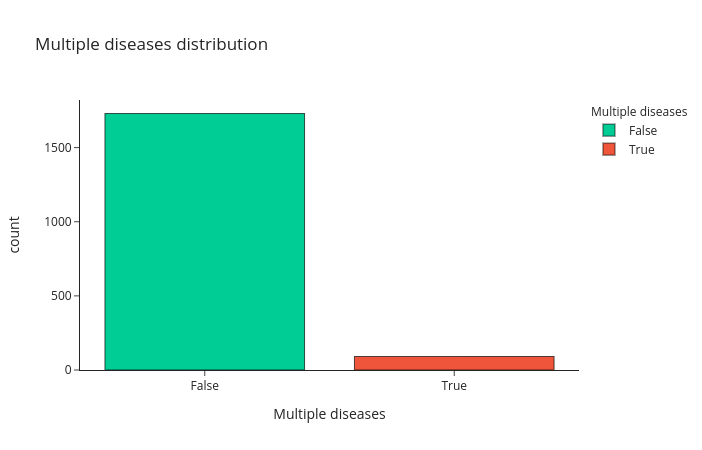

In [39]:
train_df["Multiple diseases"] = train_df["multiple_diseases"].apply(bool).apply(str)
fig = px.histogram(train_df, x="Multiple diseases", color="Multiple diseases", title="Multiple diseases distribution",\
            color_discrete_map={
                "True": px.colors.qualitative.Plotly[1],
                "False": px.colors.qualitative.Plotly[2]})
fig.update_layout(template="simple_white")
fig.data[0].marker.line.color = 'rgb(0, 0, 0)'
fig.data[0].marker.line.width = 0.5
fig.data[1].marker.line.color = 'rgb(0, 0, 0)'
fig.data[1].marker.line.width = 0.5
fig

> # 3. Image Processing & Augmentation <a id="3"></a> 

## Canny edge detection <a id="2.1"></a>

Canny is a popular edge detection algorithm, and as the name suggests, it detects the edges of objects present in an image. It was developed by John F. Canny in 1986. The algorithm involves several steps.

1. **Noise reduction:** Since edge detection is susceptible to noise in an image, we remove the noise in the image using a 5x5 Gaussian filter.


2. **Finding Intensity Gradient of the Image**: The smoothened image is then filtered with a Sobel kernel in both horizontal and vertical directions to get the first derivative in the horizontal (*G<sub>x</sub>*) and vertical (*G<sub>y</sub>*) directions. From these two images, one can find the edge gradient and direction for each pixel:

<center><img src="https://i.imgur.com/ntyjTep.png" width="300px"></center>
<center><img src="https://i.imgur.com/75qDjv6.png" width="260px"></center>

<br>

3. **Rounding:** The gradient is always perpendicular to edges. So, it is rounded to one of the four angles representing vertical, horizontal and two diagonal directions.

4. **Non-maximum suppression:** After getting the gradient magnitude and direction, a full scan of the image is done to remove any unwanted pixels which may not constitute the edge. For this, we check every pixel for being a local maximum in its neighborhood in the direction of the gradient.

5. **Hysteresis Thresholding:** This stage decides which parts are edges and which are not. For this, we need two threshold values, *minVal* and *maxVal*. Any edges with intensity gradient greater than *maxVal* are considered edges and those lesser than *minVal* are considered non-edges, and discarded. Those who lie between these two thresholds are classified edges or non-edges based on their neighborhood. If they are near “sure-edge” pixels, they are considered edges, and otherwise, they are discarded.

The result of these five steps is a two-dimensional binary map (0 or 255) indicating the location of edges on the image. Canny edge is demonstrated below with a few leaf images:

In [40]:
def edgedetection(img):
    emb_img = img.copy()
    edges = cv2.Canny(img, 100, 200)
    edge_coors = []
    for i in range(edges.shape[0]):
        for j in range(edges.shape[1]):
            if edges[i][j] != 0:
                edge_coors.append((i, j))
    
    row_min = edge_coors[np.argsort([coor[0] for coor in edge_coors])[0]][0]
    row_max = edge_coors[np.argsort([coor[0] for coor in edge_coors])[-1]][0]
    col_min = edge_coors[np.argsort([coor[1] for coor in edge_coors])[0]][1]
    col_max = edge_coors[np.argsort([coor[1] for coor in edge_coors])[-1]][1]
    new_img = img[row_min:row_max, col_min:col_max]
    
    emb_img[row_min-10:row_min+10, col_min:col_max] = [255, 0, 0]
    emb_img[row_max-10:row_max+10, col_min:col_max] = [255, 0, 0]
    emb_img[row_min:row_max, col_min-10:col_min+10] = [255, 0, 0]
    emb_img[row_min:row_max, col_max-10:col_max+10] = [255, 0, 0]
    
    fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(30, 20))
    ax[0].imshow(img, cmap='gray')
    ax[0].set_title('Original Image', fontsize=24)
    ax[1].imshow(edges, cmap='gray')
    ax[1].set_title('Canny Edges', fontsize=24)
    ax[2].imshow(emb_img, cmap='gray')
    ax[2].set_title('Bounding Box', fontsize=24)
    plt.show()

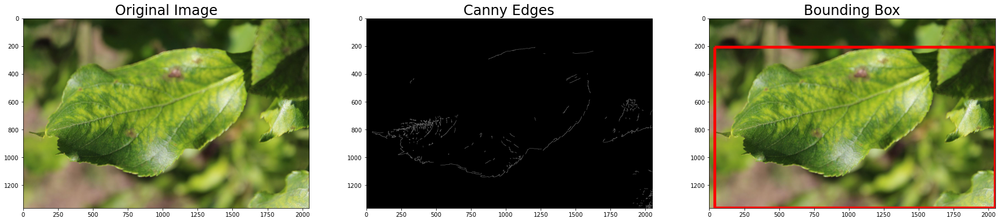

In [41]:
edgedetection(train_images[0])

## Flipping

Flipping is a simple transformation that involves index-switching on the image channels.

In [42]:
def flip(img):
    fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(30, 20))
    ax[0].imshow(img)
    ax[0].set_title('Original Image', fontsize=24)
    ax[1].imshow(cv2.flip(img, 0))
    ax[1].set_title('Vertical Flip', fontsize=24)
    ax[2].imshow(cv2.flip(img, 1))
    ax[2].set_title('Horizontal Flip', fontsize=24)
    plt.show()

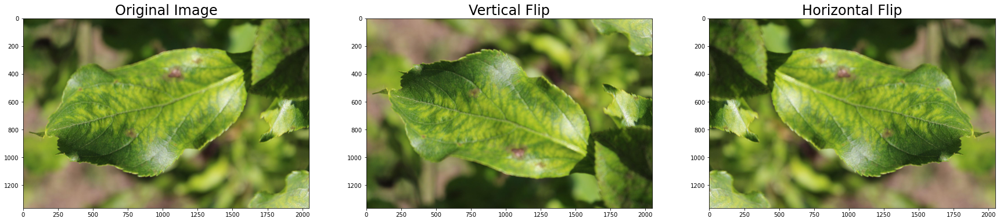

In [43]:
flip(train_images[0])

## Convolution <a id="2.3"></a>

Convolution is a rather simple algorithm which involves a kernel (a 2D matrix) which moves over the entire image, calculating dot products with each window along the way. The GIF below demonstrates convolution in action.

<center><img src="https://i.imgur.com/wYUaqR3.gif" width="450px"></center>

The above process can be summarized with an equation, where *f* is the image and *h* is the kernel. The dimensions of *f* are *(m, n)* and the kernel is a square matrix with dimensions smaller than *f*:

<center><img src="https://i.imgur.com/9scTOGv.png" width="350px"></center>
<br>

In the above equation, the kernel *h* is moving across the length and breadth of the image. The dot product of *h* with a sub-matrix or window of matrix *f* is taken at each step, hence the double summation (rows and columns). Below I demonstrate the effect of convolution on leaf images.

In [44]:
def conv(img):
    fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(20, 20))
    kernel = np.ones((7, 7), np.float32)/25
    conv = cv2.filter2D(img, -1, kernel)
    ax[0].imshow(img)
    ax[0].set_title('Original Image', fontsize=24)
    ax[1].imshow(conv)
    ax[1].set_title('Convolved Image', fontsize=24)
    plt.show()

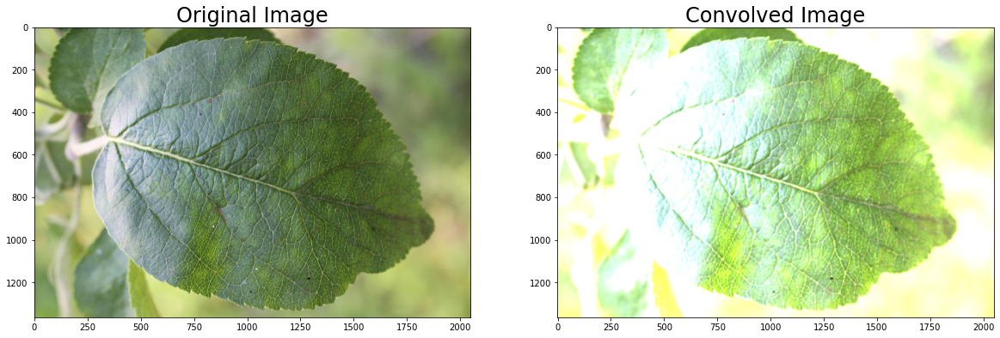

In [45]:
conv(train_images[5])

The convolution operator seems to have an apparent "sunshine" effect of the images. This may also serve the purpose of augmenting the data, thus helping to build more robust and accurate models. 

## Blurring <a id="2.4"></a>

Blurring is simply the addition of noise to the image, resulting in a less-clear image. The noise can be sampled from any distribution of choice, as long as the main content in the image does not become invisible. Only the minor details get obfuscated due to blurring. The blurring transformation can be represented using the equation below. 

<center><img src="https://i.imgur.com/zVM8HCU.png" width="220px"></center>
<br>

The example uses a Gaussian distribution with mean 0 and variance 0.1. Below I demonstrate the effect of blurring on a few leaf images:

In [46]:
def blur(img):
    fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(20, 20))
    ax[0].imshow(img)
    ax[0].set_title('Original Image', fontsize=24)
    ax[1].imshow(cv2.blur(img, (100, 100)))
    ax[1].set_title('Blurred Image', fontsize=24)
    plt.show()

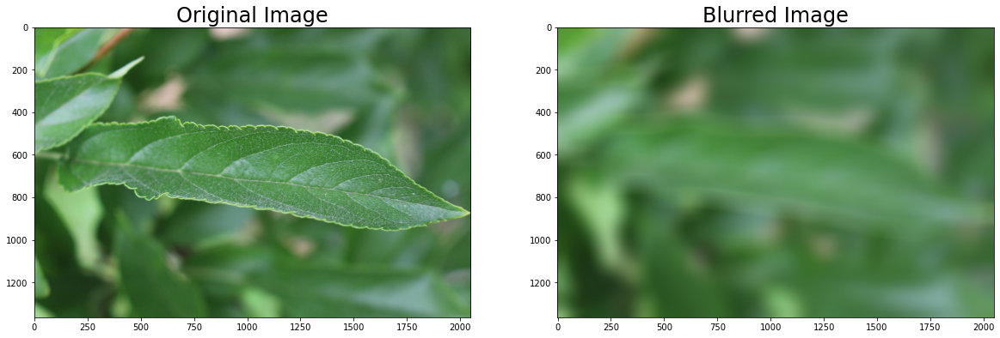

In [47]:
blur(train_images[4])

The transformation clearly blurs the image by removing detailed, low-level features, while retaining the major, high-level features. This is once again a great way to augment images and train more robust models.

## New Training Images generation using Cycle GAN

`Pix2Pix GAN` is an algorithm for image to image translation using conditional GAN's. Using this technique we can colorize black and white photos, convert google maps to google earth, etc.

`Cycle GAN` is an improved version of Pix2Pix GAN where CycleGAN works without paired examples of transformation from source to target domain, while Pix2Pix requires paired examples.

The code for CycleGAN is similar, the main difference is an additional loss function, and the use of unpaired training data. CycleGAN uses a cycle consistency loss to enable training without the need for paired data. 
In other words, it can translate from one domain to another without a one-to-one mapping between the source and target domain.

### Pix2Pix models

The generatior model could also be a res-net model but we would be using the pix2pix generator and discriminator for easy implementation, where the generator is a U-net. Cyclegan uses `instance normalization` instead of batch normalization.

There are 2 generators (G and F) and 2 discriminators (X and Y) being trained here. <br>
* Generator G learns to transform image X to image Y.(G: X->Y)
* Generator F learns to transform image Y to image X.(F: Y->X)
* Discriminator D_X learns to differentiate between image X and generated image X (F(Y)).
* Discriminator D_Y learns to differentiate between image Y and generated image Y (G(X)).
![](https://www.tensorflow.org/tutorials/generative/images/cyclegan_model.png)

In [48]:
OUTPUT_CHANNELS = 3

generator_g = pix2pix.unet_generator(OUTPUT_CHANNELS, norm_type='instancenorm')
generator_f = pix2pix.unet_generator(OUTPUT_CHANNELS, norm_type='instancenorm')

discriminator_x = pix2pix.discriminator(norm_type='instancenorm', target=False)
discriminator_y = pix2pix.discriminator(norm_type='instancenorm', target=False)

NameError: name 'pix2pix' is not defined

In [ ]:
sample_healthy = next(iter(train_healthy))
sample_md = next(iter(train_md))

In [ ]:
to_md = generator_g(sample_healthy)
to_healthy = generator_f(sample_md)

plt.rcParams.update({'font.size': 8})
plt.figure(figsize=(8, 8))
contrast = 8
imgs = [sample_healthy, to_md, sample_md, to_healthy]
title = ['healthy', 'to multiple diseases', 'multiple diseases', 'to healthy']

for i in range(len(imgs)):
    plt.subplot(2, 2, i+1)
    plt.title(title[i])
    if i % 2 == 0:
        plt.imshow(imgs[i][0] * 0.5 + 0.5)
    else:
        plt.imshow(imgs[i][0] * 0.5 * contrast + 0.5)
plt.show()

##### GANs later

> # 4. Modeling <a id="4"></a>

## Preparing the ground <a id="3.1"></a>

Before we move on to building the models, I will explain the major building blocks in pretrained CV models. Every major ImageNet model has a different architecture, but each one has the common building blocks: **Conv2D, MaxPool, ReLU**. I have already explained the mechanism behind convolution in the previous section, so I will now explain MaxPool and ReLU.

### MaxPool

Max pooling is very similar to convolution, except it involves finding the maximum value in a window instead of finding the dot product of the window with a kernel. Max pooling does not require a kernel and it is very useful in reducing the dimensionality of convolutional feature maps in CNNs. The image below demonstrates the working of MaxPool:


<center><img src="https://i.imgur.com/rBNMsfi.png" width="400px"></center>
<br></br>

The above example demonstrates max pooling with a window size of *(2, 2)*. This process can be represented with the equation below:
<br></br>
.

<center><img src="https://i.imgur.com/FRyMNhI.png" width="650px"></center>
<br></br>

In the above equation, the window moves across the image and the maximum value in each winow is calculated. Once again, this process is very important in reducing the complexity of CNNs while retaining features.

### ReLU

ReLU is an activation function commonly used in neural network architectures. *ReLU(x)* returns 0 for *x < 0* and *x* otherwise. This function helps introducenon-linearity in the neural network, thus increasing its capacity ot model the image data. The graph and equation of *ReLU* are:

<center><img src="https://i.imgur.com/eiRVQBh.png" width="400px"></center>

<center><img src="https://i.imgur.com/0mBFAH0.png" width="400px"></center>
<br></br>

As mentioned earlier, this function is non-linear and helps increase the modeling capacity of the CNN models. Now since we understand the basic building blocks of pretrained images models, let us finetune some pretained ImageNet models on TPU and visualize the results!

### Helper Functions

In [36]:
def decode_image(filename, label=None, image_size=(512, 512)):
    bits = tf.io.read_file(filename)
    image = tf.image.decode_jpeg(bits, channels=3)
    image = tf.cast(image, tf.float32) / 255.0
    image = tf.image.resize(image, image_size)
    
    if label is None:
        return image
    else:
        return image, label

def data_augment(image, label=None):
    image = tf.image.random_flip_left_right(image)
    image = tf.image.random_flip_up_down(image)
    
    if label is None:
        return image
    else:
        return image, label

In [37]:
def build_lrfn(lr_start=0.00001, lr_max=0.00005, 
               lr_min=0.00001, lr_rampup_epochs=5, 
               lr_sustain_epochs=0, lr_exp_decay=.8):

    def lrfn(epoch):
        if epoch < lr_rampup_epochs:
            lr = (lr_max - lr_start) / lr_rampup_epochs * epoch + lr_start
        elif epoch < lr_rampup_epochs + lr_sustain_epochs:
            lr = lr_max
        else:
            lr = (lr_max - lr_min) *\
                 lr_exp_decay**(epoch - lr_rampup_epochs\
                                - lr_sustain_epochs) + lr_min
        return lr
    return lrfn

## Preapre train & test sets

In [38]:
train, val, train_labels, val_labels = train_test_split(train, train_labels, test_size=0.15, random_state=2020)

### Experiment setup & strategy

In [39]:
# AUTO = tf.data.experimental.AUTOTUNE

# # Create a MirroredStrategy.
# strategy = tf.distribute.MirroredStrategy()
# print('Number of devices: {}'.format(strategy.num_replicas_in_sync))

# BATCH_SIZE = 16 * strategy.num_replicas_in_sync

BATCH_SIZE = 8

### Create Dataset objects

In [40]:
train_dataset = (
    tf.data.Dataset
    .from_tensor_slices((train, train_labels))
#     .map(decode_image, num_parallel_calls=AUTO)
#     .map(data_augment, num_parallel_calls=AUTO)
    .map(decode_image)
    .map(data_augment)
    .repeat()
    .shuffle(512)
    .batch(BATCH_SIZE)
#     .prefetch(AUTO)
)

val_dataset = (
    tf.data.Dataset
    .from_tensor_slices((val, val_labels))
#     .map(decode_image, num_parallel_calls=AUTO)
    .map(decode_image)
    .batch(BATCH_SIZE)
    .cache()
#     .prefetch(AUTO)
)

test_dataset = (
    tf.data.Dataset
    .from_tensor_slices(test)
#     .map(decode_image, num_parallel_calls=AUTO)
    .map(decode_image)
    .batch(BATCH_SIZE)
)

## Hyperparameters & Callbacks

In [41]:
lrfn = build_lrfn()
STEPS_PER_EPOCH = train_labels.shape[0] // BATCH_SIZE
lr_schedule = tf.keras.callbacks.LearningRateScheduler(lrfn, verbose=1)

Learning rate schedule: 1e-05 to 4 to 4


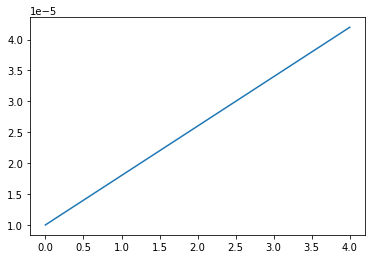

In [52]:
lr = [lrfn(epoch) for epoch in range(EPOCHS)]
plt.plot(range(EPOCHS), lr)
print("Learning rate schedule: {:.3g} to {:.3g} to {:.3g}".format(lr[0], max(range(EPOCHS)), range(EPOCHS)[-1]))

## DenseNet <a id="3.2"></a>

Densely Connected Convolutional Networks (DenseNets), are a popular CNN-based ImageNet used for a variety of applications, inclusing classification, segmentation, localization, etc. Most models before DenseNet relied solely on network depth for representational power. **Instead of drawing representational power from extremely deep or wide architectures, DenseNets exploit the potential of the network through feature reuse.** This was the main motivation behind the DenseNet architecture. Now let us train DenseNet on leaf images and evaluate its performance.

In [42]:
# # Open a strategy scope.
# with strategy.scope():
#     # Everything that creates variables should be under the strategy scope.
#     # In general this is only model construction & `compile()`.
#     model = get_compiled_model()    

### DenseNet fundamental block

The image bellow shows the fundamental block in the DenseNet architecture. The architecture mainly involves Convolution, Maxpooling, ReLU, and concatenation.

In [ ]:
SVG(tf.keras.utils.model_to_dot(Model(model.layers[0].input, model.layers[0].layers[13].output), dpi=70).create(prog='dot', format='svg'))

### Visualize model architecture

The model consists of the DenseNet head (without the top), followed by global average pooling and a dense layer (with softmax) to generate probabilities.

In [ ]:
SVG(tf.keras.utils.model_to_dot(model, dpi=70).create(prog='dot', format='svg'))

### Model Training

In [45]:
# Prepare a directory to store all the checkpoints.
checkpoint_dir = os.path.join(root_dir, "checkpoint")
if not os.path.exists(checkpoint_dir):
    os.makedirs(checkpoint_dir)

    
def get_compiled_model():
    base_model = DenseNet121(input_shape=(512, 512, 3), weights='imagenet', include_top=False)
    # Freeze the base_model
    base_model.trainable = False

    model = tf.keras.Sequential([ base_model, L.GlobalAveragePooling2D(),
                                 L.Dense(train_labels.shape[1], activation='softmax')])


    model.compile(optimizer='adam',
                      loss = 'categorical_crossentropy',
                      metrics=['categorical_accuracy'])
    model.summary()
    return model


def make_or_restore_model():
    # Either restore the latest model, or create a fresh one
    # if there is no checkpoint available.
    checkpoints = [checkpoint_dir + "/" + name for name in os.listdir(checkpoint_dir)]
    if checkpoints:
        latest_checkpoint = max(checkpoints, key=os.path.getctime)
        print("Restoring from", latest_checkpoint)
        return keras.models.load_model(latest_checkpoint)
    print("Creating a new model")
    return get_compiled_model()


def run_training(epochs=1):
    # Create a MirroredStrategy.
    strategy = tf.distribute.MirroredStrategy()

    # Open a strategy scope and create/restore the model
    with strategy.scope():
        model = make_or_restore_model()

    callbacks = [
        # This callback saves a SavedModel every epoch
        # We include the current epoch in the folder name.
        keras.callbacks.ModelCheckpoint(
            filepath=checkpoint_dir + "/ckpt-{epoch}", save_freq="epoch"
        ), lr_schedule
    ]
    
    history = model.fit(
        train_dataset,
        epochs=EPOCHS,
        steps_per_epoch=STEPS_PER_EPOCH,
        callbacks=callbacks,
        validation_data=val_dataset,
        verbose=2,
    )
    
    return history

In [46]:
history = run_training(epochs=EPOCHS)

INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)
Creating a new model
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
INFO:tensorflow:Reduce to /job:localh

### Visualize Results

In [47]:
def display_training_curves(training, validation, yaxis):
    if yaxis == "loss":
        ylabel = "Loss"
        title = "Loss vs. Epochs"
    else:
        ylabel = "Accuracy"
        title = "Accuracy vs. Epochs"
        
    fig = go.Figure()
        
    fig.add_trace(
        go.Scatter(x=np.arange(1, EPOCHS+1), mode='lines+markers', y=training, marker=dict(color="dodgerblue"),
               name="Train"))
    
    fig.add_trace(
        go.Scatter(x=np.arange(1, EPOCHS+1), mode='lines+markers', y=validation, marker=dict(color="darkorange"),
               name="Val"))
    
    fig.update_layout(title_text=title, yaxis_title=ylabel, xaxis_title="Epochs", template="plotly_white")
    fig.show()

### Scatter plots

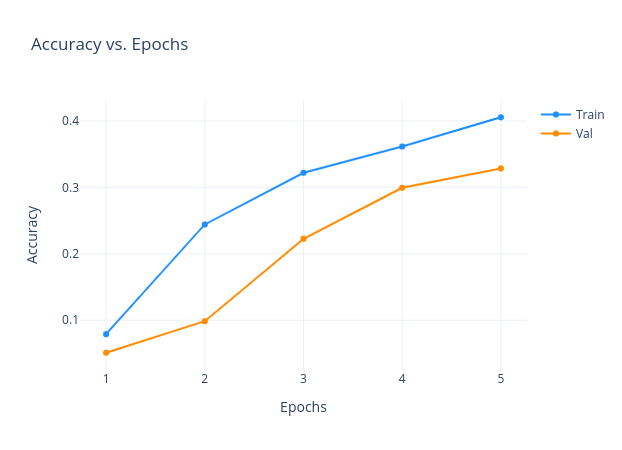

In [48]:
display_training_curves(
    history.history['categorical_accuracy'], 
    history.history['val_categorical_accuracy'], 
    'accuracy')

From the above plots, we can see that the losses decrease and accuracies increase quite consistently. The training metrics settle down very fast (after 1 or 2 epochs), whereas the validation metrics much greater volatility and start to settle down only after 7-8 epochs. This is expected because validation data is unseen and more diffcult to make predictions on than training data. 

### Animation (click ▶️)

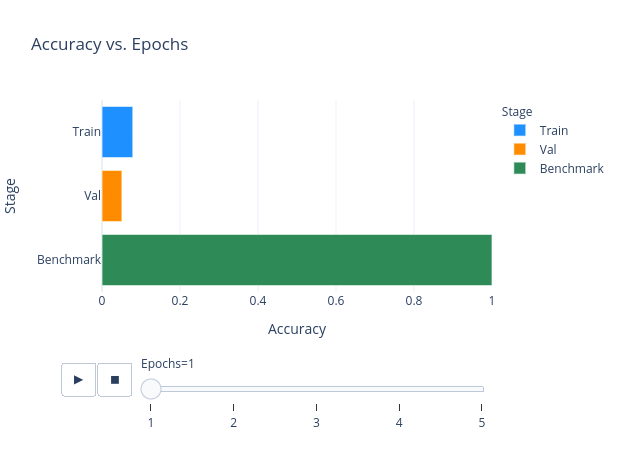

In [49]:
acc_df = pd.DataFrame(np.transpose([[*np.arange(1, EPOCHS+1).tolist()*3], ["Train"]*EPOCHS + ["Val"]*EPOCHS + ["Benchmark"]*EPOCHS,
                                     history.history['categorical_accuracy'] + history.history['val_categorical_accuracy'] + [1.0]*EPOCHS]))
acc_df.columns = ["Epochs", "Stage", "Accuracy"]
fig = px.bar(acc_df, x="Accuracy", y="Stage", animation_frame="Epochs", title="Accuracy vs. Epochs", color='Stage',
       color_discrete_map={"Train":"dodgerblue", "Val":"darkorange", "Benchmark":"seagreen"}, orientation="h")

fig.update_layout(
    xaxis = dict(
        autorange=False,
        range=[0, 1]
    )
)

fig.update_layout(template="plotly_white")

### Sample predictions

Now, I will visualize some sample predictions made by the DenseNet model. The <font color="red">red</font> bars represent the model's prediction (maximum probability), the <font color="green">green</font> represent the ground truth (label), and the rest of the bars are <font color="blue">blue</font>. When the model predicts correctly, the prediction bar is <font color="green">green</font>.

#### Helper Functions for prediction


If you intended to run this layer in float32, you can safely ignore this warning. If in doubt, this warning is likely only an issue if you are porting a TensorFlow 1.X model to TensorFlow 2.

To change all layers to have dtype float64 by default, call `tf.keras.backend.set_floatx('float64')`. To change just this layer, pass dtype='float64' to the layer constructor. If you are the author of this layer, you can disable autocasting by passing autocast=False to the base Layer constructor.



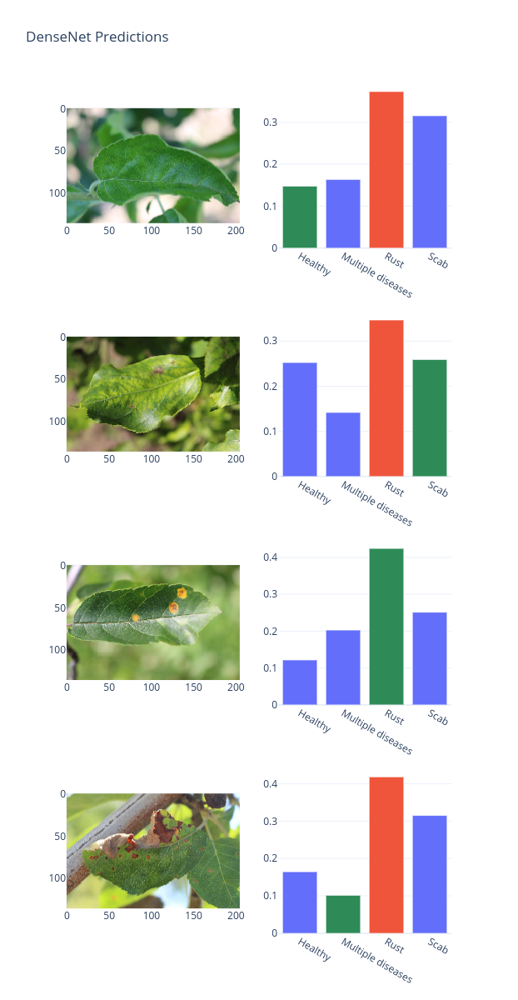

In [50]:
def process(img):
    return cv2.resize(img/255.0, (512, 512)).reshape(-1, 512, 512, 3)

def predict(img):
    return model.layers[2](model.layers[1](model.layers[0](process(img)))).numpy()[0]

fig = make_subplots(rows=4, cols=2)
preds = predict(train_images[2])

colors = {"Healthy":px.colors.qualitative.Plotly[0], "Scab":px.colors.qualitative.Plotly[0], "Rust":px.colors.qualitative.Plotly[0], "Multiple diseases":px.colors.qualitative.Plotly[0]}
if list.index(preds.tolist(), max(preds)) == 0:
    pred = "Healthy"
if list.index(preds.tolist(), max(preds)) == 1:
    pred = "Scab"
if list.index(preds.tolist(), max(preds)) == 2:
    pred = "Rust"
if list.index(preds.tolist(), max(preds)) == 3:
    pred = "Multiple diseases"

colors[pred] = px.colors.qualitative.Plotly[1]
colors["Healthy"] = "seagreen"
colors = [colors[val] for val in colors.keys()]
fig.add_trace(go.Image(z=cv2.resize(train_images[2], (205, 136))), row=1, col=1)
fig.add_trace(go.Bar(x=["Healthy", "Multiple diseases", "Rust", "Scab"], y=preds, marker=dict(color=colors)), row=1, col=2)
fig.update_layout(height=1200, width=800, title_text="DenseNet Predictions", showlegend=False)

preds = predict(train_images[0])
colors = {"Healthy":px.colors.qualitative.Plotly[0], "Scab":px.colors.qualitative.Plotly[0], "Rust":px.colors.qualitative.Plotly[0], "Multiple diseases":px.colors.qualitative.Plotly[0]}
if list.index(preds.tolist(), max(preds)) == 0:
    pred = "Healthy"
if list.index(preds.tolist(), max(preds)) == 1:
    pred = "Multiple diseases"
if list.index(preds.tolist(), max(preds)) == 2:
    pred = "Rust"
if list.index(preds.tolist(), max(preds)) == 3:
    pred = "Scab"
    
colors[pred] = px.colors.qualitative.Plotly[1]
colors["Multiple diseases"] = "seagreen"
colors = [colors[val] for val in colors.keys()]
fig.add_trace(go.Image(z=cv2.resize(train_images[0], (205, 136))), row=2, col=1)
fig.add_trace(go.Bar(x=["Healthy", "Multiple diseases", "Rust", "Scab"], y=preds, marker=dict(color=colors)), row=2, col=2)

preds = predict(train_images[3])
colors = {"Healthy":px.colors.qualitative.Plotly[0], "Scab":px.colors.qualitative.Plotly[0], "Rust":px.colors.qualitative.Plotly[0], "Multiple diseases":px.colors.qualitative.Plotly[0]}
if list.index(preds.tolist(), max(preds)) == 0:
    pred = "Healthy"
if list.index(preds.tolist(), max(preds)) == 1:
    pred = "Multiple diseases"
if list.index(preds.tolist(), max(preds)) == 2:
    pred = "Rust"
if list.index(preds.tolist(), max(preds)) == 3:
    pred = "Scab"
    
colors[pred] = px.colors.qualitative.Plotly[1]
colors["Rust"] = "seagreen"
colors = [colors[val] for val in colors.keys()]
fig.add_trace(go.Image(z=cv2.resize(train_images[3], (205, 136))), row=3, col=1)
fig.add_trace(go.Bar(x=["Healthy", "Multiple diseases", "Rust", "Scab"], y=preds, marker=dict(color=colors)), row=3, col=2)

preds = predict(train_images[1])
colors = {"Healthy":px.colors.qualitative.Plotly[0], "Scab":px.colors.qualitative.Plotly[0], "Rust":px.colors.qualitative.Plotly[0], "Multiple diseases":px.colors.qualitative.Plotly[0]}
if list.index(preds.tolist(), max(preds)) == 0:
    pred = "Healthy"
if list.index(preds.tolist(), max(preds)) == 1:
    pred = "Multiple diseases"
if list.index(preds.tolist(), max(preds)) == 2:
    pred = "Rust"
if list.index(preds.tolist(), max(preds)) == 3:
    pred = "Scab"
    
colors[pred] = px.colors.qualitative.Plotly[1]
colors["Scab"] = "seagreen"
colors = [colors[val] for val in colors.keys()]
fig.add_trace(go.Image(z=cv2.resize(train_images[1], (205, 136))), row=4, col=1)
fig.add_trace(go.Bar(x=["Healthy", "Multiple diseases", "Rust", "Scab"], y=preds, marker=dict(color=colors)), row=4, col=2)

fig.update_layout(template="plotly_white")

We can see that DenseNet predicts leaf diseases with great accuracy. No red or blue bars are seen. The probabilities are very polarized (one very high and the rest very low), indicating that the model is making these predictions with great confidence.

### Prediction

In [51]:
probs_dnn = model.predict(test_dataset, verbose=1)

228/228 [==============================] - 64s 282ms/step


## EfficientNet <a id="3.3"></a>

EfficientNet is another popular (more recent) CNN-based ImageNet model which achieved the SOTA on several image-based tasks in 2019. EfficientNet performs model scaling in an innovative way to achieve excellent accuracy with significantly fewer parameters. It achieves the same if not greater accuracy than ResNet and DenseNet with a much shallower architecture. Now let us train EfficientNet on leaf images and evaluate its performance.

In [ ]:
with strategy.scope():
    model = tf.keras.Sequential([efn.EfficientNetB7(input_shape=(512, 512, 3),
                                                    weights='imagenet',
                                                    include_top=False),
                                 L.GlobalAveragePooling2D(),
                                 L.Dense(train_labels.shape[1],
                                         activation='softmax')])
    
    
        
    model.compile(optimizer='adam',
                  loss = 'categorical_crossentropy',
                  metrics=['categorical_accuracy'])
    model.summary()

### EfficientNet fundamental block

The image below shows the fundamental block in the EfficientNet architecture. This architecture involves more addition and multiplication-based operators than DenseNet. These operations are less parameter-intensive than concatenation, which is much more common in DenseNet. Such transformations help EfficientNet achieve great efficiency (in terms of performance per parameter).

In [ ]:
SVG(tf.keras.utils.model_to_dot(Model(model.layers[0].input, model.layers[0].layers[11].output), dpi=70).create(prog='dot', format='svg'))

### Visualize model architecture

The model consists of the EfficientNet head (without the top), followed by global average pooling and a dense layer (with softmax) to generate probabilities.

In [ ]:
SVG(tf.keras.utils.model_to_dot(model, dpi=70).create(prog='dot', format='svg'))

### Model Training

In [ ]:
history = model.fit(train_dfset,
                    epochs=EPOCHS,
                    callbacks=[lr_schedule],
                    steps_per_epoch=STEPS_PER_EPOCH,
                    validation_data=valid_dataset)

### Visualize Results

### Scatter plots

In [ ]:
display_training_curves(
    history.history['categorical_accuracy'], 
    history.history['val_categorical_accuracy'], 
    'accuracy')

From the above plots, we can see that the losses decrease and accuracies increase quite consistently. The training metrics settle down very fast (after 1 or 2 epochs), whereas the validation metrics much greater volatility and start to settle down only after 7-8 epochs. This is expected because validation data is unseen and more diffcult to make predictions on than training data. 

### Animation (click ▶️)

In [ ]:
acc_df = pd.DataFrame(np.transpose([[*np.arange(1, EPOCHS+1).tolist()*3], ["Train"]*EPOCHS + ["Val"]*EPOCHS + ["Benchmark"]*EPOCHS,
                                     history.history['categorical_accuracy'] + history.history['val_categorical_accuracy'] + [1.0]*EPOCHS]))
acc_df.columns = ["Epochs", "Stage", "Accuracy"]
fig = px.bar(acc_df, x="Accuracy", y="Stage", animation_frame="Epochs", title="Accuracy vs. Epochs", color='Stage',
       color_discrete_map={"Train":"dodgerblue", "Val":"darkorange", "Benchmark":"seagreen"}, orientation="h")

fig.update_layout(
    xaxis = dict(
        autorange=False,
        range=[0, 1]
    )
)

fig.update_layout(template="plotly_white")

### Prediction

In [ ]:
probs_efn = model.predict(test_dataset, verbose=1)

## EfficientNet NoisyStudent <a id="3.4"></a>

EfficientNet NoisyStudent, released in 2020, is based on EfficientNet and uses semi-supervised learning on noisy images to learn rich visual representation. It outperformed EfficientNet on several tasks and is the SOTA at the time of writing (March 2020). Now let us train EfficientNet NoisyStudent on leaf images and evaluate its performance.

In [ ]:
with strategy.scope():
    model = tf.keras.Sequential([efn.EfficientNetB7(input_shape=(512, 512, 3),
                                                    weights='noisy-student',
                                                    include_top=False),
                                 L.GlobalAveragePooling2D(),
                                 L.Dense(train_labels.shape[1],
                                         activation='softmax')])
    
    
        
    model.compile(optimizer='adam',
                  loss = 'categorical_crossentropy',
                  metrics=['categorical_accuracy'])
    model.summary()

### EfficientNet Noisy Student fundamental block

The image below shows the fundamental block in the EfficientNet Noisy Student architecture. It has same architecture as EfficientNet. Only the weights are different, as they are obtained through semi-supervision.

In [ ]:
SVG(tf.keras.utils.model_to_dot(Model(model.layers[0].input, model.layers[0].layers[11].output), dpi=70).create(prog='dot', format='svg'))

### Visualize model architecture

The model consists of the EfficientNet head (without the top), followed by global average pooling and a dense layer (with softmax) to generate probabilities.

In [ ]:
SVG(tf.keras.utils.model_to_dot(model, dpi=70).create(prog='dot', format='svg'))

### Model Training

In [ ]:
history = model.fit(train_dfset,
                    epochs=EPOCHS,
                    callbacks=[lr_schedule],
                    steps_per_epoch=STEPS_PER_EPOCH,
                    validation_data=valid_dataset)

### Visualize Results

### Scatter plots

In [ ]:
display_training_curves(
    history.history['categorical_accuracy'], 
    history.history['val_categorical_accuracy'], 
    'accuracy')

From the above plots, we can see that the losses decrease and accuracies increase quite consistently. The training metrics settle down very fast (after 1 or 2 epochs), whereas the validation metrics much greater volatility and start to settle down only after 7-8 epochs. This is expected because validation data is unseen and more diffcult to make predictions on than training data. 

### Animation (click ▶️)

In [ ]:
acc_df = pd.DataFrame(np.transpose([[*np.arange(1, EPOCHS+1).tolist()*3], ["Train"]*EPOCHS + ["Val"]*EPOCHS + ["Benchmark"]*EPOCHS,
                                     history.history['categorical_accuracy'] + history.history['val_categorical_accuracy'] + [1.0]*EPOCHS]))
acc_df.columns = ["Epochs", "Stage", "Accuracy"]
fig = px.bar(acc_df, x="Accuracy", y="Stage", animation_frame="Epochs", title="Accuracy vs. Epochs", color='Stage',
       color_discrete_map={"Train":"dodgerblue", "Val":"darkorange", "Benchmark":"seagreen"}, orientation="h")

fig.update_layout(
    xaxis = dict(
        autorange=False,
        range=[0, 1]
    )
)

fig.update_layout(template="plotly_white")

### Prediction

In [ ]:
probs_efn = model.predict(test_dataset, verbose=1)
# Submission
#sub.loc[:, 'healthy':] = probs_efnns
#sub.to_csv('submission_efnns.csv', index=False)
#sub.head()

## Ensembling <a id="3.5"></a>

Ensembling involves the averaging of multiple prediction vectos to reduce errors and improve accuracy. Now, I will ensemble predictions from DenseNet and EfficientNet to (hopefully) produce better results.

In [ ]:
ensemble_1, ensemble_2, ensemble_3 = [sub]*3

ensemble_1.loc[:, 'healthy':] = 0.50*probs_dnn + 0.50*probs_efn
ensemble_2.loc[:, 'healthy':] = 0.25*probs_dnn + 0.75*probs_efn
ensemble_3.loc[:, 'healthy':] = 0.75*probs_dnn + 0.25*probs_efn

ensemble_1.to_csv('submission_ensemble_1.csv', index=False)
ensemble_2.to_csv('submission_ensemble_2.csv', index=False)
ensemble_3.to_csv('submission_ensemble_3.csv', index=False)

## Conclusion

1. Image processing and augmentation methods such as edge detection, depth estimation, flipping, etc can be used to build  models.

2. Several pretrained models like DenseNet and EfficientNet can be used to classify leaf diseases with high accuracy.

3. Ensembling, stacking, and strong validation techniques may lead to more accurate and robust models.

#### Reference

1. [Plant Pathology](https://www.kaggle.com/indiano/plant-pathology-2020-eda-models/edit)
2. [Image augmentation packages](https://www.kaggle.com/parulpandey/overview-of-popular-image-augmentation-packages)
3. [Cycle GAN to balance classes](https://www.kaggle.com/basu369victor/cycle-gan-to-balance-imbalanced-diseased-leaves)